In [1]:
%time 


import geopandas as gpd
from shapely.geometry import Point, polygon, LineString

from shapely.geometry import Point, Polygon, LineString
from shapely import geometry
from shapely.geometry import MultiPolygon, Polygon, LineString, Point, MultiPoint
import IPython.display as display
#import contextily as ctx
#import mplleaflet
#import geoplot.crs as gcrs

import matplotlib.pyplot as plt
import seaborn as sb
import pandas as pd
import numpy as np
from datetime import datetime
import ipywidgets as widgets
import copy
import warnings
warnings.filterwarnings('ignore')

#from bioinfokit import analys, visuz

pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 500)

CPU times: total: 0 ns
Wall time: 0 ns


In [2]:
df = pd.read_csv(r'D:\DIPLOMADO_ANALISIS_ESPACIAL\od_abril_2022.csv' , encoding = 'UTF-8', sep=',', low_memory=False)


In [3]:
df.count()

avg_people    1812037
week          1812037
start_date    1812037
end_date      1812037
time_block    1812037
zona_p        1812037
zona_hogar    1812037
dtype: int64

In [4]:
df.head(2)

,avg_people,week,start_date,end_date,time_block,zona_p,zona_hogar
0,1.0,16,2022-04-18,2022-04-24,T1,13101131008,13502011001
1,1.0,16,2022-04-18,2022-04-24,T2,13101131008,13111011001


In [5]:
df.dtypes


avg_people    float64
week            int64
start_date     object
end_date       object
time_block     object
zona_p          int64
zona_hogar      int64
dtype: object

In [6]:
# Función para obtener los dos primeros dígitos
def obtener_dos_primeros_digitos(numero):
    return str(numero)[:2]

In [7]:
# Aplicar la función a toda la columna 'mi_columna'
df['region'] = df['zona_hogar'].apply(lambda x: obtener_dos_primeros_digitos(x))

In [8]:
df

,avg_people,week,start_date,end_date,time_block,zona_p,zona_hogar,region
0,1.000000,16,2022-04-18,2022-04-24,T1,13101131008,13502011001,13
1,1.000000,16,2022-04-18,2022-04-24,T2,13101131008,13111011001,13
2,1.000000,16,2022-04-18,2022-04-24,T1,13101131008,13124011001,13
3,1.000000,16,2022-04-18,2022-04-24,T2,13101131008,13101041005,13
4,1.000000,16,2022-04-18,2022-04-24,T1,13101131008,13114091001,13
...,...,...,...,...,...,...,...,...
1812032,129.800000,16,2022-04-18,2022-04-24,T1,13119051007,13119051007,13
1812033,2.333333,16,2022-04-18,2022-04-24,T2,13119051007,13119051002,13
1812034,1.666667,16,2022-04-18,2022-04-24,T2,13119051007,13119161002,13
1812035,1.666667,16,2022-04-18,2022-04-24,T1,13119051007,13119051009,13


In [9]:
df['region'].unique()

array(['13'], dtype=object)

In [10]:
# cargar capa de zonas censales 
zonas =  gpd.read_file(r'D:\capas_shapefile\cartografia_censo_2017\r13\R13\ZONA_C17.shp')

In [11]:
zonas.count()

REGION        1865
NOM_REGION    1865
PROVINCIA     1865
NOM_PROVIN    1865
COMUNA        1865
NOM_COMUNA    1865
URBANO        1865
DISTRITO      1865
LOC_ZON       1865
GEOCODIGO     1865
SHAPE_Leng    1865
SHAPE_Area    1865
geometry      1865
dtype: int64

In [12]:
#para el analisis pueden hacer lo siguiente: unir la geometria de zonas con el codigo de las zonas hogar y 
#obtener el promedio de personas que salen de sus hogares y responder, desde donde se producen las concentraciones 
#de donde salen mas personas

# luego en otra gdf o capa hacen lo mismo pero unen los datos con las zonas de destino y responder hacia donde se dirigen 
#mayoritariamente la población durante esa semana, y en qué horarios. 

In [13]:
zonas.rename(columns={"GEOCODIGO": "zona_p" }, inplace = True )
zonas.tail(1)

,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,URBANO,DISTRITO,LOC_ZON,zona_p,SHAPE_Leng,SHAPE_Area,geometry
1864,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13132,VITACURA,VITACURA,4,3,13132041003,0.051267,0.000082,"POLYGON ((-70.52750 -33.37744, -70.52764 -33.3..."


In [14]:
df["zona_p"] = df["zona_p"].apply(str)

In [15]:
df_llegadas = df.merge(zonas, on= 'zona_p')#DESTINO 
df_llegadas.head(2)

,avg_people,week,start_date,end_date,time_block,zona_p,zona_hogar,region,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,URBANO,DISTRITO,LOC_ZON,SHAPE_Leng,SHAPE_Area,geometry
0,1.0,16,2022-04-18,2022-04-24,T1,13101131008,13502011001,13,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13101,SANTIAGO,SANTIAGO,13,8,0.006614,0.000003,"POLYGON ((-70.65571 -33.45048, -70.65646 -33.4..."
1,1.0,16,2022-04-18,2022-04-24,T2,13101131008,13111011001,13,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13101,SANTIAGO,SANTIAGO,13,8,0.006614,0.000003,"POLYGON ((-70.65571 -33.45048, -70.65646 -33.4..."


In [16]:
df_llegadas_t1 = df_llegadas.loc[df_llegadas['time_block'] == "T1"]

In [17]:
df_llegadas_t1["time_block"].unique()

array(['T1'], dtype=object)

In [18]:
df_llegadas_t1.head(2)

,avg_people,week,start_date,end_date,time_block,zona_p,zona_hogar,region,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,URBANO,DISTRITO,LOC_ZON,SHAPE_Leng,SHAPE_Area,geometry
0,1.0,16,2022-04-18,2022-04-24,T1,13101131008,13502011001,13,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13101,SANTIAGO,SANTIAGO,13,8,0.006614,0.000003,"POLYGON ((-70.65571 -33.45048, -70.65646 -33.4..."
2,1.0,16,2022-04-18,2022-04-24,T1,13101131008,13124011001,13,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13101,SANTIAGO,SANTIAGO,13,8,0.006614,0.000003,"POLYGON ((-70.65571 -33.45048, -70.65646 -33.4..."


In [19]:
df_llegadas_t1 = df_llegadas_t1.groupby('zona_p').agg({'avg_people': 'sum'}).reset_index()

In [20]:
df_llegadas_t1

,zona_p,avg_people
0,13101011001,1528.100000
1,13101011002,2388.700000
2,13101011003,4204.666667
3,13101011004,3747.833333
4,13101011005,1981.483333
...,...,...
1859,13605031003,2259.566667
1860,13605031004,1314.816667
1861,13605031005,715.750000
1862,13605031006,1717.266667


In [21]:
#nuevamente hay que unir a la geometria para visualizar las llegadas 
df_llegadas_t1.dtypes

zona_p         object
avg_people    float64
dtype: object

In [22]:
#esto es un dataframe
df_llegadas_t1 = df_llegadas_t1.merge(zonas, on= 'zona_p')
df_llegadas_t1.head(2)

,zona_p,avg_people,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,URBANO,DISTRITO,LOC_ZON,SHAPE_Leng,SHAPE_Area,geometry
0,13101011001,1528.1,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13101,SANTIAGO,SANTIAGO,1,1,0.021846,0.00002,"POLYGON ((-70.63925 -33.43663, -70.63932 -33.4..."
1,13101011002,2388.7,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13101,SANTIAGO,SANTIAGO,1,2,0.017378,0.00001,"POLYGON ((-70.64645 -33.43683, -70.64718 -33.4..."


In [23]:
df_llegadas_t1.dtypes

zona_p          object
avg_people     float64
REGION          object
NOM_REGION      object
PROVINCIA       object
NOM_PROVIN      object
COMUNA          object
NOM_COMUNA      object
URBANO          object
DISTRITO         int64
LOC_ZON          int64
SHAPE_Leng     float64
SHAPE_Area     float64
geometry      geometry
dtype: object

In [24]:
df_llegadas_t1= gpd.GeoDataFrame(df_llegadas_t1, geometry='geometry')

In [25]:
df_llegadas_t1.count()

zona_p        1864
avg_people    1864
REGION        1864
NOM_REGION    1864
PROVINCIA     1864
NOM_PROVIN    1864
COMUNA        1864
NOM_COMUNA    1864
URBANO        1864
DISTRITO      1864
LOC_ZON       1864
SHAPE_Leng    1864
SHAPE_Area    1864
geometry      1864
dtype: int64

In [26]:
# zonas.explore()

In [27]:
#creamos una gdf solo con la columna avg people
x = df_llegadas_t1[['avg_people']]

In [28]:
from sklearn.preprocessing import StandardScaler
#normalizamos para que las columnas tengan la misma magnitud, eso es importante para clusterizar 
scaler = StandardScaler()
scaled_features = scaler.fit_transform(x)

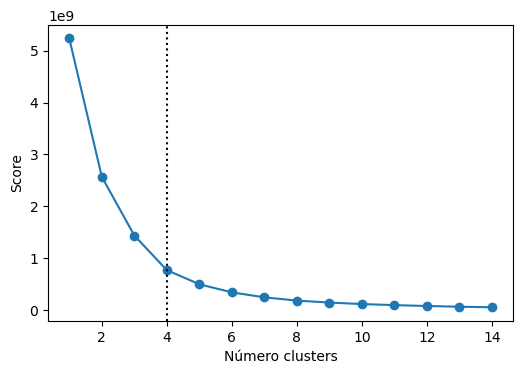

In [29]:
from sklearn.cluster import KMeans

# Método elbow para identificar el número óptimo de clusters
#Con la clase sklearn.cluster.KMeans de Scikit-Learn se pueden entrenar modelos de clustering utilizando el algoritmo k-means.
#Entre sus parámetros destacan:

#n_clusters: determina el número  K  de clusters que se van a generar.

#init: estrategia para asignar los centroides iniciales. Por defecto se emplea 'k-means++', una estrategia que trata de alejar los centroides lo máximo posible facilitando la convergencia. Sin embargo, esta estrategia puede ralentizar el proceso cuando hay muchos datos, si esto ocurre, es mejor utilizar 'random'.

#n_init: determina el número de veces que se va a repetir el proceso, cada vez con una asignación aleatoria inicial distinta. Es recomendable que este último valor sea alto, entre 10-25, para no obtener resultados subóptimos debido a una iniciación poco afortunada del proceso.

#max_iter: número máximo de iteraciones permitidas.

#random_state: semilla para garantizar la reproducibilidad de los resultados.
# ==============================================================================
range_n_clusters = range(1, 15)
inertias = []

for n_clusters in range_n_clusters:
    modelo_kmeans = KMeans(
                        n_clusters   = n_clusters, 
                        n_init       = 20, 
                        random_state = 123
                    )
    modelo_kmeans.fit(x)
    inertias.append(modelo_kmeans.inertia_)

fig, ax = plt.subplots(1, 1, figsize=(6, 3.84))
ax.plot(range_n_clusters, inertias, marker='o')
#ax.set_title("Evolución de la varianza intra-cluster total")
ax.set_xlabel('Número clusters')
ax.set_ylabel('Score')
plt.axvline(4, color='k', ls="dotted");

In [30]:
#nuestra gdf tiene tanto las coordenadas como la geometria en punto, vamos a hacer un modelo y vamos a definir el numero de 
#k cluster 
from sklearn.cluster import KMeans

modelo = KMeans(n_clusters=4) #creamos un objeto llamado modelo de la clase Kmeans
y_kmeans = modelo.fit_predict(x) # en esta parte cada punto se asocia o integra a un grupo de los 4 cluster

In [31]:
#vamos a agregar los grupos de cluster 
df_llegadas_t1['grupo'] = y_kmeans
df_llegadas_t1.head(3)

,zona_p,avg_people,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,URBANO,DISTRITO,LOC_ZON,SHAPE_Leng,SHAPE_Area,geometry,grupo
0,13101011001,1528.100000,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13101,SANTIAGO,SANTIAGO,1,1,0.021846,0.000020,"POLYGON ((-70.63925 -33.43663, -70.63932 -33.4...",2
1,13101011002,2388.700000,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13101,SANTIAGO,SANTIAGO,1,2,0.017378,0.000010,"POLYGON ((-70.64645 -33.43683, -70.64718 -33.4...",2
2,13101011003,4204.666667,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13101,SANTIAGO,SANTIAGO,1,3,0.021360,0.000017,"POLYGON ((-70.63527 -33.43685, -70.63525 -33.4...",1


In [32]:
from shapely.geometry import Polygon
import folium

In [33]:
df_llegadas_t1.head(2)

,zona_p,avg_people,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,URBANO,DISTRITO,LOC_ZON,SHAPE_Leng,SHAPE_Area,geometry,grupo
0,13101011001,1528.1,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13101,SANTIAGO,SANTIAGO,1,1,0.021846,0.00002,"POLYGON ((-70.63925 -33.43663, -70.63932 -33.4...",2
1,13101011002,2388.7,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13101,SANTIAGO,SANTIAGO,1,2,0.017378,0.00001,"POLYGON ((-70.64645 -33.43683, -70.64718 -33.4...",2


In [34]:
# Seleccionar solo las columnas necesarias para la visualización del mapa
df_llegadas_t1 = df_llegadas_t1[['zona_p', 'avg_people','grupo', 'geometry']].copy()


In [35]:
df_llegadas_t1['grupo'].nunique()

4

In [36]:
gdf = df_llegadas_t1

In [37]:
import folium
import geopandas as gpd
from folium.plugins import FloatImage

# Suponiendo que tienes un GeoDataFrame llamado gdf con tus datos y la columna 'cluster'

# Crear un mapa de Folium centrado en la Región Metropolitana de Santiago
m = folium.Map(location=[-33.4489, -70.6693], zoom_start=10)

# Colores y etiquetas para los clusters
colors = ['blue', 'green', 'red', 'purple']
labels = ['Cluster 0', 'Cluster 1', 'Cluster 2', 'Cluster 3']

# Iterar sobre los clusters únicos y agregar al mapa cada grupo con su respectivo color
for cluster_id, color, label in zip(sorted(gdf['grupo'].unique()), colors, labels):
    cluster_data = gdf[gdf['grupo'] == cluster_id]
    geo_json = folium.GeoJson(cluster_data,
                              style_function=lambda feature, color=color: {
                                  'fillColor': color,
                                  'color': 'black',
                                  'weight': 1,
                                  'dashArray': '5, 5',
                                  'fillOpacity': 0.5
                              })
    folium.Popup(label).add_to(geo_json)
    geo_json.add_to(m)

# Agregar leyenda personalizada al mapa
legend_html = '''
     <div style="position: fixed; 
                 bottom: 50px; left: 50px; width: 120px; height: 120px; 
                 border:2px solid grey; z-index:9999; font-size:12px;
                 background-color: white;
                 opacity: 0.8;
                 ">
     <p style="text-align:center;"> <b> Legend </b> </p>
     <p style="text-align:left; margin-left:10px;"> Cluster 0: <span style="color:blue;">&#9632;</span> </p>
     <p style="text-align:left; margin-left:10px;"> Cluster 1: <span style="color:green;">&#9632;</span> </p>
     <p style="text-align:left; margin-left:10px;"> Cluster 2: <span style="color:red;">&#9632;</span> </p>
     <p style="text-align:left; margin-left:10px;"> Cluster 3: <span style="color:purple;">&#9632;</span> </p>
     </div>
     '''
legend = FloatImage(legend_html, bottom=75, left=75)
legend.add_to(m)

# Mostrar el mapa interactivo en el Notebook
m


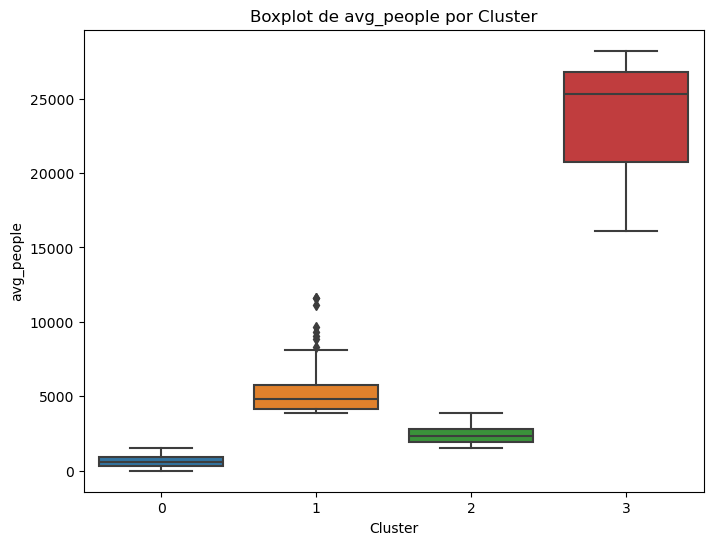

In [38]:
import matplotlib.pyplot as plt
import seaborn as sns

# Suponiendo que tienes un DataFrame df_llegadas_t1 con las columnas 'zona_p', 'avg_people', 'cluster', 'geometry'

# Crear el gráfico de boxplot
plt.figure(figsize=(8, 6))
sns.boxplot(x='grupo', y='avg_people', data=gdf)
plt.title('Boxplot de avg_people por Cluster')
plt.xlabel('Cluster')
plt.ylabel('avg_people')
plt.show()


# observar ahora los origenes 


In [39]:
zonas.rename(columns={"zona_p": "zona_hogar" }, inplace = True )
zonas.tail(1)

,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,URBANO,DISTRITO,LOC_ZON,zona_hogar,SHAPE_Leng,SHAPE_Area,geometry
1864,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13132,VITACURA,VITACURA,4,3,13132041003,0.051267,0.000082,"POLYGON ((-70.52750 -33.37744, -70.52764 -33.3..."


In [40]:
df["zona_hogar"] = df["zona_hogar"].apply(str)

In [41]:
df_origen = df.merge(zonas, on= 'zona_hogar')#DESTINO 
df_origen.head(2)

,avg_people,week,start_date,end_date,time_block,zona_p,zona_hogar,region,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,URBANO,DISTRITO,LOC_ZON,SHAPE_Leng,SHAPE_Area,geometry
0,1.0,16,2022-04-18,2022-04-24,T1,13101131008,13502011001,13,13,REGIÓN METROPOLITANA DE SANTIAGO,135,MELIPILLA,13502,ALHUÉ,VILLA ALHUÉ,1,1,0.087029,0.000254,"POLYGON ((-71.09853 -34.02734, -71.09753 -34.0..."
1,1.0,16,2022-04-18,2022-04-24,T2,13120011008,13502011001,13,13,REGIÓN METROPOLITANA DE SANTIAGO,135,MELIPILLA,13502,ALHUÉ,VILLA ALHUÉ,1,1,0.087029,0.000254,"POLYGON ((-71.09853 -34.02734, -71.09753 -34.0..."


In [42]:
df_origen_t1 = df_origen.loc[df_origen['time_block'] == "T1"]

In [43]:
df_origen_t1 = df_origen_t1.groupby('zona_hogar').agg({'avg_people': 'sum'}).reset_index()

In [44]:
#esto es un dataframe
df_origen_t1 = df_origen_t1.merge(zonas, on= 'zona_hogar')
df_origen_t1.head(2)

,zona_hogar,avg_people,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,URBANO,DISTRITO,LOC_ZON,SHAPE_Leng,SHAPE_Area,geometry
0,13101011001,880.533333,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13101,SANTIAGO,SANTIAGO,1,1,0.021846,0.00002,"POLYGON ((-70.63925 -33.43663, -70.63932 -33.4..."
1,13101011002,1341.833333,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13101,SANTIAGO,SANTIAGO,1,2,0.017378,0.00001,"POLYGON ((-70.64645 -33.43683, -70.64718 -33.4..."


In [45]:
df_origen_t1.count()

zona_hogar    1855
avg_people    1855
REGION        1855
NOM_REGION    1855
PROVINCIA     1855
NOM_PROVIN    1855
COMUNA        1855
NOM_COMUNA    1855
URBANO        1855
DISTRITO      1855
LOC_ZON       1855
SHAPE_Leng    1855
SHAPE_Area    1855
geometry      1855
dtype: int64

In [46]:
df_origen_t1= gpd.GeoDataFrame(df_origen_t1, geometry='geometry')

In [47]:
#creamos una gdf solo con la columna avg people
x1 = df_origen_t1[['avg_people']]

In [48]:
from sklearn.preprocessing import StandardScaler
#normalizamos para que las columnas tengan la misma magnitud, eso es importante para clusterizar 
scaler = StandardScaler()
scaled_features = scaler.fit_transform(x1)

In [49]:
scaled_features

array([[-0.48967934],
       [-0.10226506],
       [ 1.05570866],
       ...,
       [-0.12383473],
       [ 0.51049003],
       [ 0.01489144]])

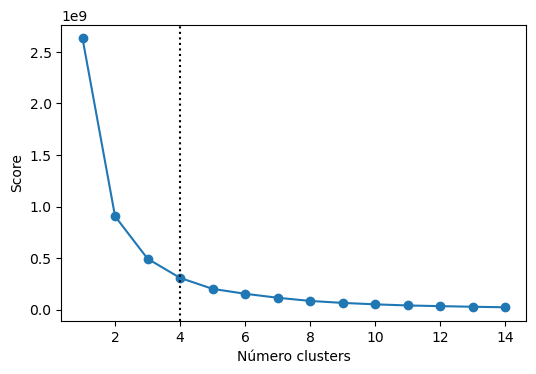

In [50]:
from sklearn.cluster import KMeans

# Método elbow para identificar el número óptimo de clusters
#Con la clase sklearn.cluster.KMeans de Scikit-Learn se pueden entrenar modelos de clustering utilizando el algoritmo k-means.
#Entre sus parámetros destacan:

#n_clusters: determina el número  K  de clusters que se van a generar.

#init: estrategia para asignar los centroides iniciales. Por defecto se emplea 'k-means++', una estrategia que trata de alejar los centroides lo máximo posible facilitando la convergencia. Sin embargo, esta estrategia puede ralentizar el proceso cuando hay muchos datos, si esto ocurre, es mejor utilizar 'random'.

#n_init: determina el número de veces que se va a repetir el proceso, cada vez con una asignación aleatoria inicial distinta. Es recomendable que este último valor sea alto, entre 10-25, para no obtener resultados subóptimos debido a una iniciación poco afortunada del proceso.

#max_iter: número máximo de iteraciones permitidas.

#random_state: semilla para garantizar la reproducibilidad de los resultados.
# ==============================================================================
range_n_clusters = range(1, 15)
inertias = []

for n_clusters in range_n_clusters:
    modelo_kmeans = KMeans(
                        n_clusters   = n_clusters, 
                        n_init       = 20, 
                        random_state = 123
                    )
    modelo_kmeans.fit(x1)
    inertias.append(modelo_kmeans.inertia_)

fig, ax = plt.subplots(1, 1, figsize=(6, 3.84))
ax.plot(range_n_clusters, inertias, marker='o')
#ax.set_title("Evolución de la varianza intra-cluster total")
ax.set_xlabel('Número clusters')
ax.set_ylabel('Score')
plt.axvline(4, color='k', ls="dotted");

In [51]:
#nuestra gdf tiene tanto las coordenadas como la geometria en punto, vamos a hacer un modelo y vamos a definir el numero de 
#k cluster 
from sklearn.cluster import KMeans

modelo = KMeans(n_clusters=4) #creamos un objeto llamado modelo de la clase Kmeans
y_kmeans = modelo.fit_predict(x1) # en esta parte cada punto se asocia o integra a un grupo de los 4 cluster

In [52]:
#vamos a agregar los grupos de cluster 
df_origen_t1['grupo'] = y_kmeans
df_origen_t1.head(3)

,zona_hogar,avg_people,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,URBANO,DISTRITO,LOC_ZON,SHAPE_Leng,SHAPE_Area,geometry,grupo
0,13101011001,880.533333,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13101,SANTIAGO,SANTIAGO,1,1,0.021846,0.000020,"POLYGON ((-70.63925 -33.43663, -70.63932 -33.4...",1
1,13101011002,1341.833333,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13101,SANTIAGO,SANTIAGO,1,2,0.017378,0.000010,"POLYGON ((-70.64645 -33.43683, -70.64718 -33.4...",3
2,13101011003,2720.650000,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13101,SANTIAGO,SANTIAGO,1,3,0.021360,0.000017,"POLYGON ((-70.63527 -33.43685, -70.63525 -33.4...",0


In [53]:
df_origen_t1 = df_origen_t1[['zona_hogar', 'avg_people','grupo', 'geometry']].copy()

In [54]:
import folium
import geopandas as gpd
from folium.plugins import FloatImage

# Suponiendo que tienes un GeoDataFrame llamado gdf con tus datos y la columna 'cluster'

# Crear un mapa de Folium centrado en la Región Metropolitana de Santiago
m = folium.Map(location=[-33.4489, -70.6693], zoom_start=10)

# Colores y etiquetas para los clusters
colors = ['blue', 'green', 'red', 'purple']
labels = ['Cluster 0', 'Cluster 1', 'Cluster 2', 'Cluster 3']

# Iterar sobre los clusters únicos y agregar al mapa cada grupo con su respectivo color
for cluster_id, color, label in zip(sorted(df_origen_t1['grupo'].unique()), colors, labels):
    cluster_data = df_origen_t1[df_origen_t1['grupo'] == cluster_id]
    geo_json = folium.GeoJson(cluster_data,
                              style_function=lambda feature, color=color: {
                                  'fillColor': color,
                                  'color': 'black',
                                  'weight': 1,
                                  'dashArray': '5, 5',
                                  'fillOpacity': 0.5
                              })
    folium.Popup(label).add_to(geo_json)
    geo_json.add_to(m)

# Agregar leyenda personalizada al mapa
legend_html = '''
     <div style="position: fixed; 
                 bottom: 50px; left: 50px; width: 120px; height: 120px; 
                 border:2px solid grey; z-index:9999; font-size:12px;
                 background-color: white;
                 opacity: 0.8;
                 ">
     <p style="text-align:center;"> <b> Legend </b> </p>
     <p style="text-align:left; margin-left:10px;"> Cluster 0: <span style="color:blue;">&#9632;</span> </p>
     <p style="text-align:left; margin-left:10px;"> Cluster 1: <span style="color:green;">&#9632;</span> </p>
     <p style="text-align:left; margin-left:10px;"> Cluster 2: <span style="color:red;">&#9632;</span> </p>
     <p style="text-align:left; margin-left:10px;"> Cluster 3: <span style="color:purple;">&#9632;</span> </p>
     </div>
     '''
legend = FloatImage(legend_html, bottom=75, left=75)
legend.add_to(m)

# Mostrar el mapa interactivo en el Notebook
m

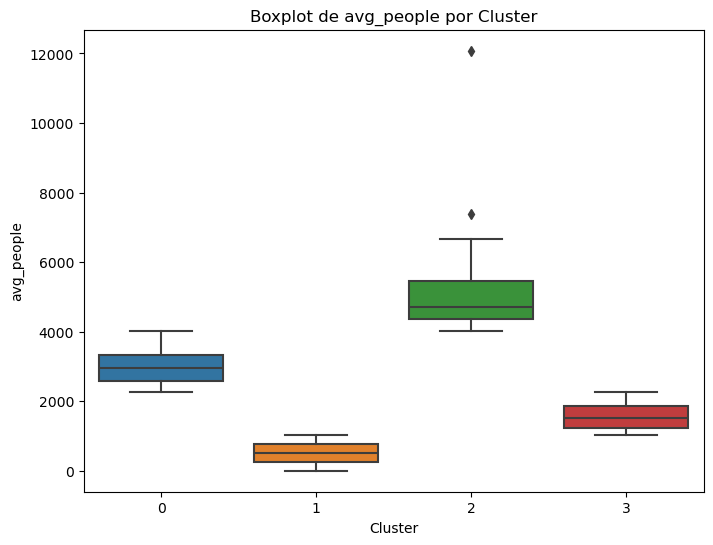

In [55]:
import matplotlib.pyplot as plt
import seaborn as sns

# Suponiendo que tienes un DataFrame df_llegadas_t1 con las columnas 'zona_p', 'avg_people', 'cluster', 'geometry'

# Crear el gráfico de boxplot
plt.figure(figsize=(8, 6))
sns.boxplot(x='grupo', y='avg_people', data=df_origen_t1)
plt.title('Boxplot de avg_people por Cluster')
plt.xlabel('Cluster')
plt.ylabel('avg_people')
plt.show()
